<a href="https://colab.research.google.com/github/AlicanKrtl/ObjectDetection/blob/main/chess_yolov7.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Chess pieces data taken from roboflow public dataset

In [1]:
!curl -L "https://public.roboflow.com/ds/GwADX3ebmA?key=UAKqmkYZ8Z" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   902  100   902    0     0   2039      0 --:--:-- --:--:-- --:--:--  2040
100 77.9M  100 77.9M    0     0  71.3M      0  0:00:01  0:00:01 --:--:--  135M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
 extracting: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/0b47311f426ff926578c9d738d683e76_jpg.rf.0b55f43ac16aa65c889558d8ea757072.jpg  
 extracting: test/images/1c0060ef868bdc326ce5e6389cb6732f_jpg.rf.9ce88078ea356949f4ab7ad9cfdfc62d.jpg  
 extracting: test/images/2f6fb003bb89cd401322a535acb42f65_jpg.rf.91ad9df05bd1f86bab67c8368ae5e4ad.jpg  
 extracting: test/images/410993714e325a1de3e394ffe860df3a_jpg.rf.519bf0fdbd5e38cd44cae1cfebc98536.jpg  
 extracting: test/images/4e3117459d759798537eb52cf5bf534d_jpg.rf.5b99421bf416463a8c75c

In [2]:
# Create new directories
!mkdir -p images/train
!mkdir -p images/valid
!mkdir -p images/test

!mkdir -p labels/train
!mkdir -p labels/valid
!mkdir -p labels/test

# Move train images
!mv train/images/* images/train/
# Move train labels
!mv train/labels/* labels/train/

# Move val images
!mv valid/images/* images/valid/
# Move val labels
!mv valid/labels/* labels/valid/

# Move test images
!mv test/images/* images/test/
# Move test labels
!mv test/labels/* labels/test/

# remove previous folders
!rm -rf train
!rm -rf valid
!rm -rf test

## Resize images

In [3]:
from PIL import Image
import os
import glob
import cv2
import imutils

def change_main_folder(path):
    # change tablet-dataset-cropped name with data
    path_list = path.split("/")
    path = "/".join(path_list[:-3]+["data"]+path_list[-3:])
    return path

# Function to resize an image and its bounding box
def resize_and_pad_image(image_path, annotation_path, target_size):
    # Open the image using Pillow (PIL)
    image = cv2.imread(image_path)
    image_path = change_main_folder(image_path)

    # Resize the image
    image = imutils.resize(image, width=target_size)

    # Load bounding box annotations (YOLO format: class x_center y_center width height)
    with open(annotation_path, 'r') as annotation_file:
        annotations = annotation_file.readlines()

    # Adjust bounding box coordinates based on the scaling factors
    adjusted_annotations = []
    for annotation in annotations:
        parts = annotation.strip().split()
        class_id = parts[0]
        x_center = float(parts[1])
        y_center = float(parts[2])
        width = float(parts[3])
        height = float(parts[4])
        adjusted_annotations.append(f"{class_id} {x_center} {y_center} {width} {height}")

    # Save the resized image
    os.makedirs("/".join(image_path.split("/")[:-1]), exist_ok=True)
    cv2.imwrite(image_path.replace('.txt', '.jpg'), image)

    # Save adjusted bounding box annotations to a new annotation file
    annotation_path = change_main_folder(annotation_path)
    os.makedirs("/".join(annotation_path.split("/")[:-1]), exist_ok=True)
    with open(annotation_path, 'w') as output_annotation_file:
        for annotation in adjusted_annotations:
            output_annotation_file.write(annotation + '\n')

# Specify the input folder containing the images
images = glob.glob('/content/images/*/*.jpg')
output_folder = '/content/data'

# Create the output folder if it doesn't exist
os.makedirs(output_folder, exist_ok=True)

# Iterate through the image files in the input folder
for file_name in images:
    if file_name.endswith('.jpg'):
        # Construct the path to the annotation file based on the image file name
        annotation_path = file_name.replace('.jpg', '.txt').replace('images', 'labels')
        # Resize the image and adjust bounding box annotations
        resize_and_pad_image(file_name, annotation_path, target_size=640)


## Select most common class annotations

In [4]:
import os
from collections import Counter
import glob

# Specify the directory containing YOLO annotation text files
annotations = glob.glob("/content/data/labels/*/*")  # Replace with the path to your directory

# Initialize a Counter to count class occurrences
class_counter = Counter()

# Iterate through the YOLO annotation files
for filename in annotations:
    if filename.endswith(".txt"):
        with open(filename, 'r') as file:
            lines = file.readlines()
            for line in lines:
                parts = line.strip().split()
                if len(parts) > 0:
                    class_id = int(parts[0])
                    class_counter[class_id] += 1

# Get the most common classes and their counts
most_common_classes = class_counter.most_common()

# Print the most common classes and their counts
for class_id, count in most_common_classes:
    print(f"Class ID: {class_id}, Count: {count}")


Class ID: 4, Count: 659
Class ID: 10, Count: 639
Class ID: 6, Count: 201
Class ID: 3, Count: 196
Class ID: 9, Count: 184
Class ID: 12, Count: 184
Class ID: 7, Count: 172
Class ID: 8, Count: 149
Class ID: 2, Count: 147
Class ID: 1, Count: 140
Class ID: 11, Count: 111
Class ID: 5, Count: 87
Class ID: 0, Count: 1


## Delete lines belong to classes whose annotation counts are lower than threshold

In [5]:
class_counter_dict = dict(class_counter)
class_most_common = {key: value for key, value in class_counter_dict.items() if value > 600}

int_list = list(range(13))
classes_to_delete = [x for x in int_list if x not in class_most_common]
print("remain class num",len(int_list) - len(classes_to_delete))

remain class num 2


In [6]:
old_new_indexs = {4:0, 10:1}

In [7]:
classes_to_delete

[0, 1, 2, 3, 5, 6, 7, 8, 9, 11, 12]

In [8]:
import os

# Specify the directory containing YOLO annotation text files
annotations = glob.glob("/content/data/labels/*/*")  # Replace with the path to your directory

# Iterate through the YOLO annotation files
for filename in annotations:
    if filename.endswith(".txt"):
        with open(filename, 'r') as file:
            lines = file.readlines()

        # Filter lines to exclude class IDs in the list
        filtered_lines = [line for line in lines if int(line.strip().split()[0]) not in classes_to_delete]

        new_lines = []
        for line in lines:
            parts = line.strip().split()
            if parts:
                old_index = int(parts[0])
                if old_index in old_new_indexs:
                    new_index = old_new_indexs[old_index]
                    parts[0] = str(new_index)
                    new_line = ' '.join(parts) + "\n"
                    new_lines.append(new_line)

        # Overwrite the original file with the filtered content
        with open(filename, 'w') as file:
            file.writelines(new_lines)

## Check classes if out of class_list_index

In [9]:
allowed_class_indices = [0, 1]

# Function to check class indices in a text annotation
def check_class_indices(annotation_file):
    with open(annotation_file, 'r') as file:
        for line in file:
            # Split the line into parts (assuming space-separated format)
            parts = line.strip().split()

            if len(parts) < 1:
                continue  # Skip empty lines

            # Parse the class index (assuming it's the first element)
            try:
                class_index = int(parts[0])
                if class_index not in allowed_class_indices:
                    print(f"Found invalid class index: {class_index} in {annotation_file}")
            except ValueError:
                print(f"Error parsing class index in {annotation_file}: {parts[0]}")

# Process all annotation files in a directory (replace 'annotations/' with your directory path)
import os

annotations = glob.glob("/content/yolov7/data/labels/*.txt")  # Replace with your directory path
for filename in annotations:
    if filename.endswith(".txt"):
        check_class_indices(filename)

# Resized img and bboxes

/content/data/images/test/c4943d83c06a12ad5e0399d19514a4ca_jpg.rf.8b0040b3b68009f6f700ea28fb1aa491.jpg
(428, 640, 3)


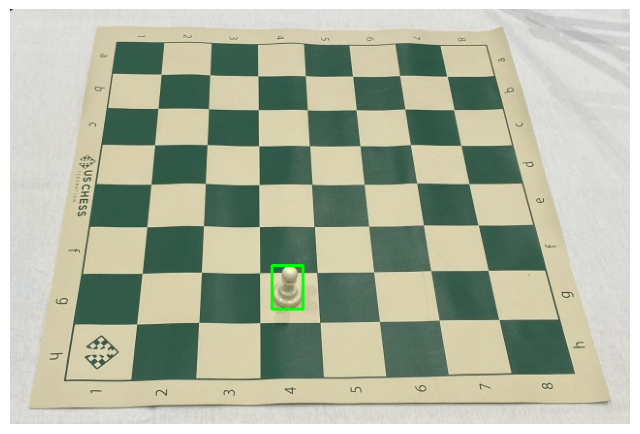

/content/data/images/test/2f6fb003bb89cd401322a535acb42f65_jpg.rf.91ad9df05bd1f86bab67c8368ae5e4ad.jpg
(428, 640, 3)


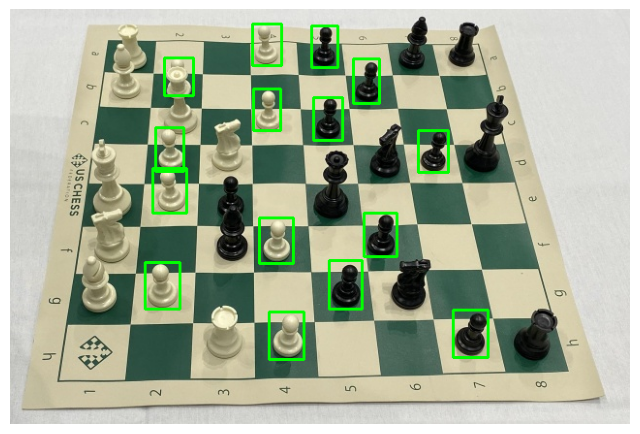

/content/data/images/test/cf4769d0586df6b3fb0dc618d9f8abe6_jpg.rf.326565beb891e3656f7083109897a48b.jpg
(428, 640, 3)


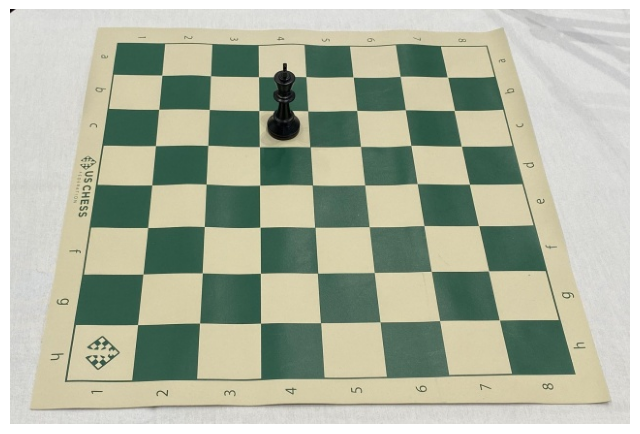

/content/data/images/test/e0d38d159ad3a801d0304d7e275812cc_jpg.rf.fa0bb8160816a373df824349a24a11e7.jpg
(428, 640, 3)


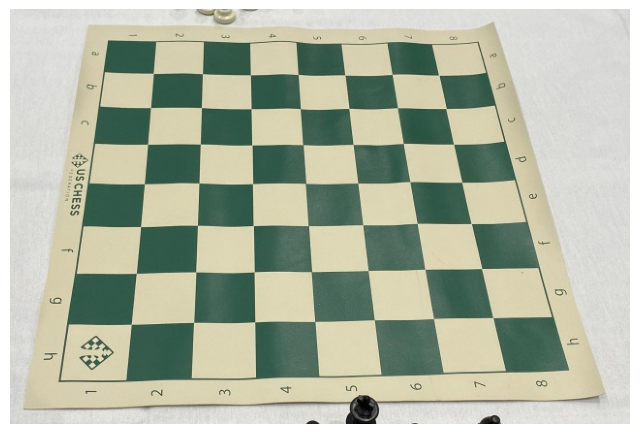

/content/data/images/test/cfc306bf86176b92ffc1afbb98d7896f_jpg.rf.a3779da7c72dfa583f9fffa23c231beb.jpg
(428, 640, 3)


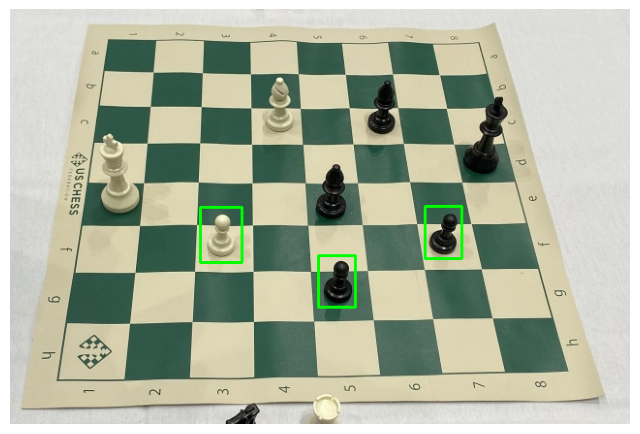

/content/data/images/test/e4147f3d8819fc5d67a9f72596bd9e47_jpg.rf.ff3718b0109da4fea85bf6ff5631104c.jpg
(428, 640, 3)


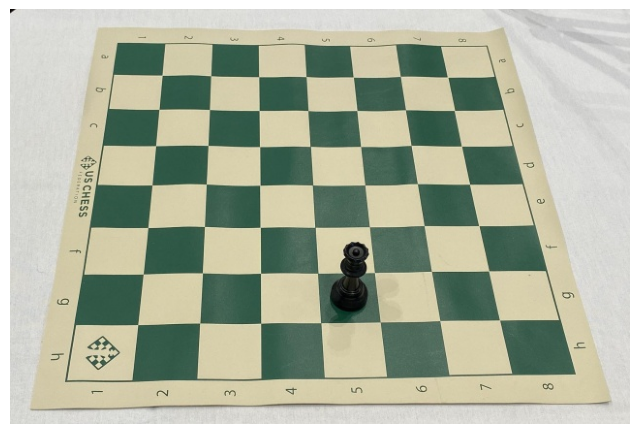

/content/data/images/test/b526b661a33ff481231d1342aff2a266_jpg.rf.b63c85ea45c4e3a665915fddee8c76f9.jpg
(428, 640, 3)


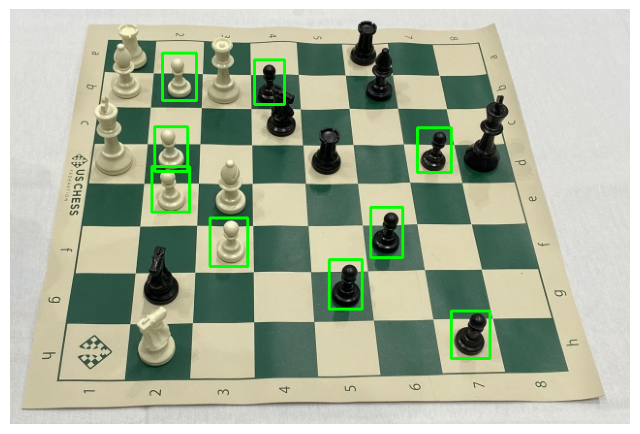

/content/data/images/test/IMG_0159_JPG.rf.1cf4f243b5072d63e492711720df35f7.jpg
(428, 640, 3)


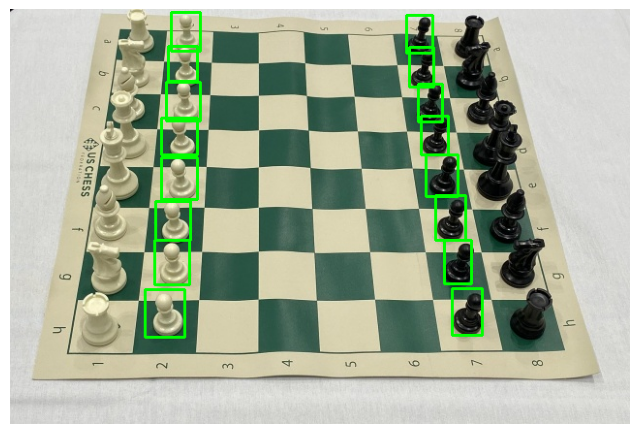

/content/data/images/test/b9402881fa580d0eb8b9b98845417550_jpg.rf.087d716cdfdd9cf2cb65b437af716d4d.jpg
(428, 640, 3)


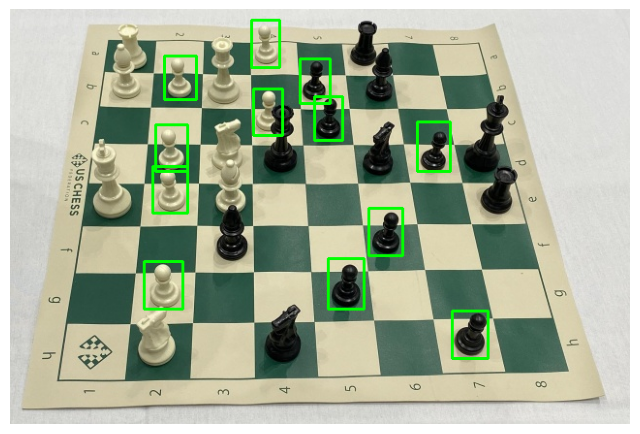

/content/data/images/test/7a34d8620235048917b28bcfd3b5572b_jpg.rf.71653deb6fe88ad472dabea12353373d.jpg
(428, 640, 3)


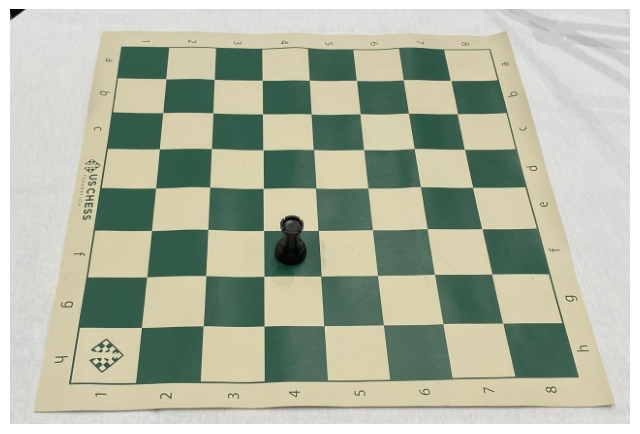

/content/data/images/test/IMG_0170_JPG.rf.6e336797b63833d78997207d352a44fc.jpg
(428, 640, 3)


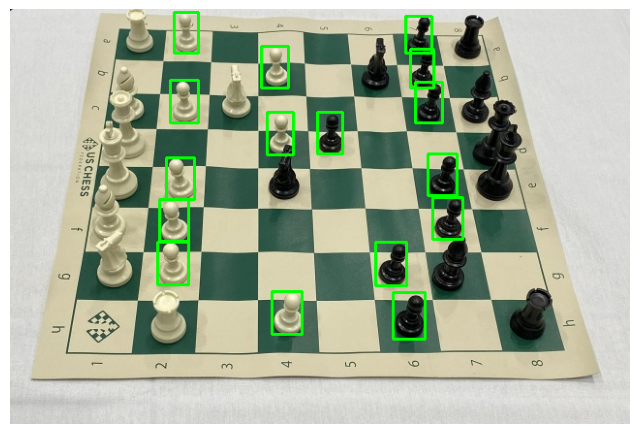

/content/data/images/test/410993714e325a1de3e394ffe860df3a_jpg.rf.519bf0fdbd5e38cd44cae1cfebc98536.jpg
(428, 640, 3)


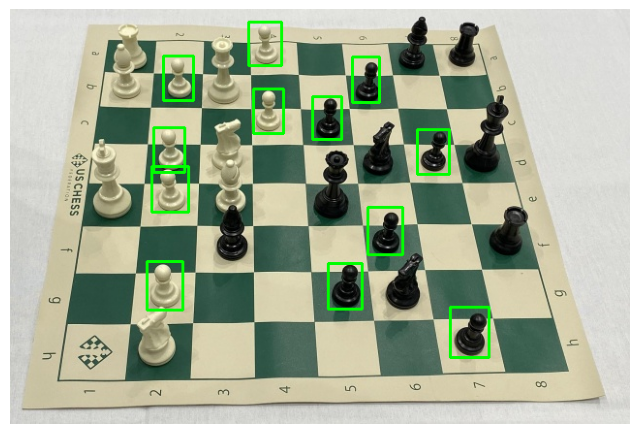

/content/data/images/test/b4ff4132c8c85da97d8bf9a2a4ed3e3d_jpg.rf.51d1d3e2f2ae5b116c7daf5a304e75ad.jpg
(428, 640, 3)


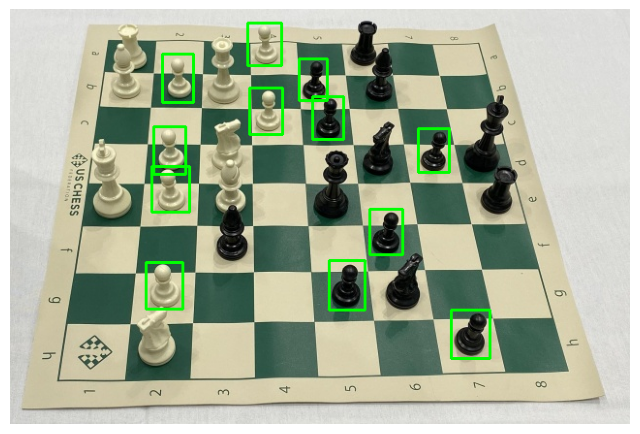

/content/data/images/test/f1a24b6bb778ee11ba33687415aa84f2_jpg.rf.6e35192bbbb13f887540067e07d5d660.jpg
(428, 640, 3)


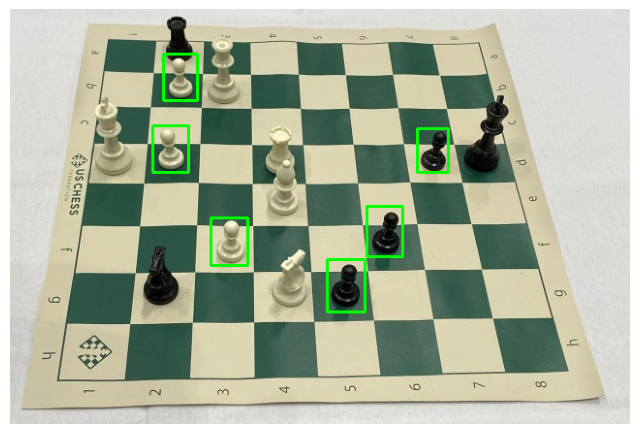

/content/data/images/test/749e9074a77f8d34d86e2218f26cdab4_jpg.rf.8079f8abd9f24ec16e76fcbf18489f46.jpg
(428, 640, 3)


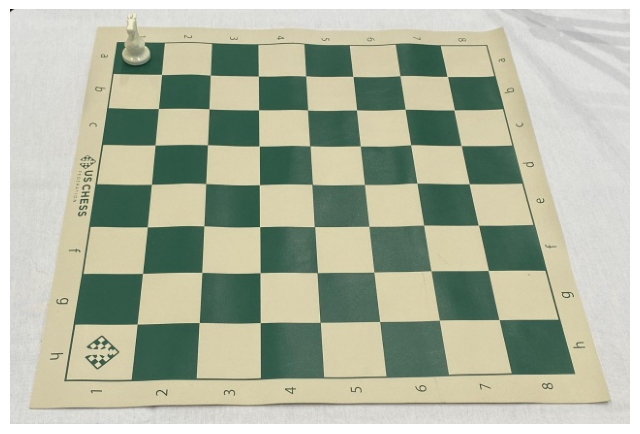

/content/data/images/test/IMG_0169_JPG.rf.b1530b71278953ad465d06863135c71e.jpg
(428, 640, 3)


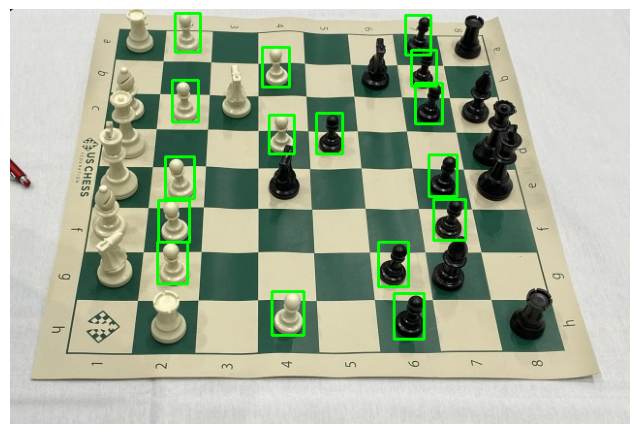

/content/data/images/test/5a35ba2ec3e0d0b2b12b1758a8ac29aa_jpg.rf.a907af85301c729635d6ab1c31eb31b2.jpg
(428, 640, 3)


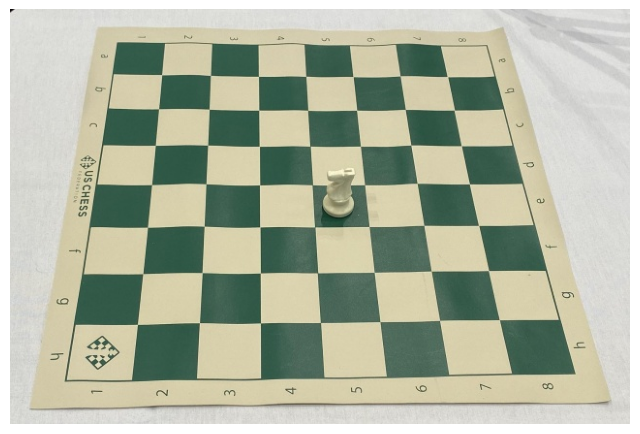

/content/data/images/test/a3863d0be6002c21b20ac88817b2c56f_jpg.rf.e421134b139d57e02e7df9468a35c1fb.jpg
(428, 640, 3)


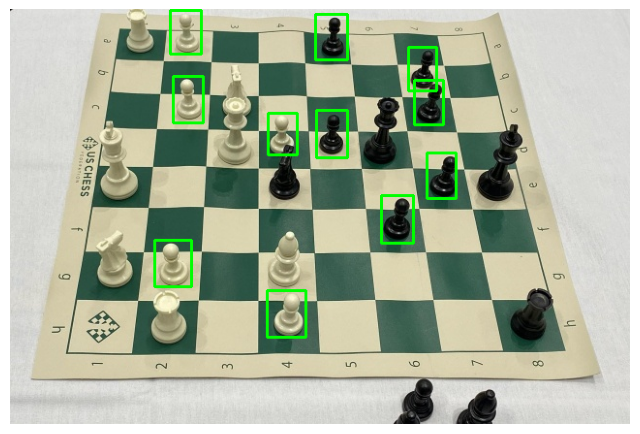

/content/data/images/test/73a38a5c8f8f1b09f093f304660d5326_jpg.rf.2d2fa2f4b419d9f2a57fb82d38d8bc6b.jpg
(428, 640, 3)


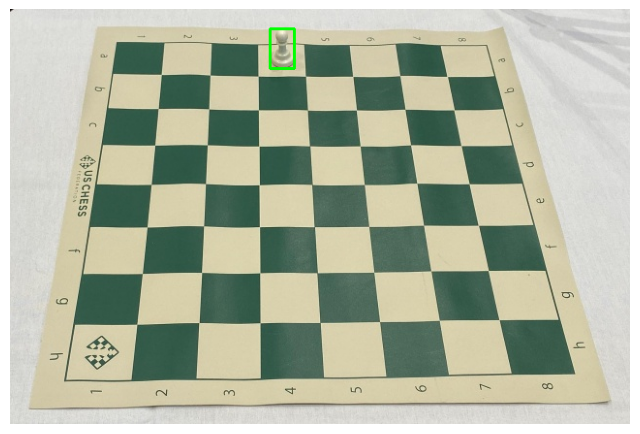

/content/data/images/test/1c0060ef868bdc326ce5e6389cb6732f_jpg.rf.9ce88078ea356949f4ab7ad9cfdfc62d.jpg
(428, 640, 3)


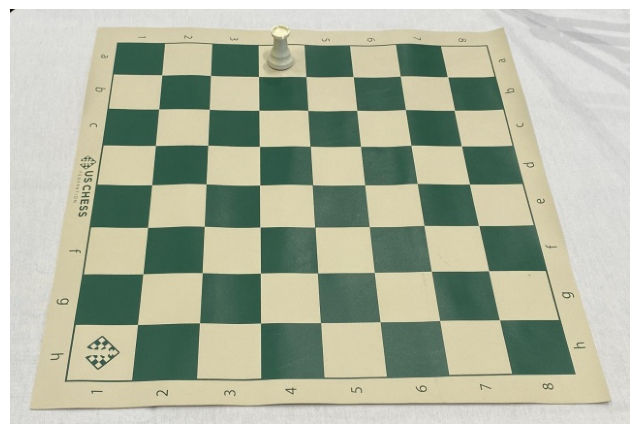

In [10]:
import cv2
import matplotlib.pyplot as plt
import glob

# Path to the image file (modify as needed)
image_paths = glob.glob('/content/data/images/*/*.jpg')  # Replace with your image path

# Path to the YOLO format annotation file (modify as needed)
annotation_path = '/content/image.txt'  # Replace with your annotation path

for image_path in image_paths[:20]:
    # Load the image using OpenCV
    image = cv2.imread(image_path)
    # Open the annotation file and read bounding box coordinates (YOLO format: class x_center y_center width height)
    annotation_path = image_path.replace('.jpg', '.txt').replace('images', 'labels')
    with open(annotation_path, 'r') as annotation_file:
        annotations = annotation_file.readlines()

    # Iterate through the bounding box annotations
    for annotation in annotations:
        parts = annotation.strip().split()
        class_id = int(parts[0])
        x_center = float(parts[1]) * image.shape[1]
        y_center = float(parts[2]) * image.shape[0]
        width = float(parts[3]) * image.shape[1]
        height = float(parts[4]) * image.shape[0]

        # Calculate the coordinates of the bounding box
        x1 = int(x_center - width/2)
        y1 = int(y_center - height/2)
        x2 = int(x_center + width/2)
        y2 = int(y_center + height/2)
        # Draw the bounding box on the image
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)

    # Convert the image from BGR to RGB for displaying with matplotlib
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Display the image with bounding box annotations
    print(image_path)
    print(image_rgb.shape)
    plt.figure(figsize=(8, 8))
    plt.imshow(image_rgb)
    plt.axis('off')
    plt.show()

In [11]:
import os
os.chdir("/content")
!rm -rf "/content/yolov7"

In [12]:
!git clone https://github.com/WongKinYiu/yolov7.git

Cloning into 'yolov7'...
remote: Enumerating objects: 1191, done.
remote: Total 1191 (delta 0), reused 0 (delta 0), pack-reused 1191
Receiving objects: 100% (1191/1191), 74.22 MiB | 16.33 MiB/s, done.
Resolving deltas: 100% (515/515), done.


In [13]:
import shutil

source_folder = '/content/data/images'
destination_folder = '/content/yolov7/data'
shutil.move(source_folder, destination_folder)

source_folder = '/content/data/labels'
destination_folder = '/content/yolov7/data'
shutil.move(source_folder, destination_folder)

'/content/yolov7/data/labels'

In [14]:
# move all images and labels
images = glob.glob("/content/yolov7/data/images/*/*")
labels = glob.glob("/content/yolov7/data/labels/*.txt")

In [15]:
import os
os.chdir("/content/yolov7")

In [17]:
train = []
val = []
test = []

for img in images:
  path_list = img.split("/")
  if path_list[-2]=="train":
    train.append(img)

  if path_list[-2]=="valid":
    val.append(img)

  if path_list[-2]=="test":
    test.append(img)

# Path to the output text file
output_file = 'data/train.txt'
# Write the file paths to the text file
with open(output_file, 'w') as file:
    for file_path in train:
        file.write(file_path + '\n')

output_file = 'data/val.txt'
with open(output_file, 'w') as file:
    for file_path in val:
        file.write(file_path + '\n')

output_file = 'data/test.txt'
with open(output_file, 'w') as file:
    for file_path in test:
        file.write(file_path + '\n')

# Create a YAML file named 'custom.yaml' and paste the text below into it.

# arrange data.yaml

In [18]:
!mv /content/data.yaml data/

In [ ]:
train: ./data/train.txt
val: ./data/val.txt
test: ./data/test.txt

nc: 2
names: ['black-pawn', 'white-pawn']

if have all classes

In [ ]:
train: ./data/train.txt
val: ./data/val.txt
test: ./data/test.txt

nc: 13
names: ['bishop', 'black-bishop', 'black-king', 'black-knight', 'black-pawn', 'black-queen', 'black-rook', 'white-bishop', 'white-king', 'white-knight', 'white-pawn', 'white-queen', 'white-rook']

# Training

In [22]:
!python train.py --batch-size 32 --data data/data.yaml --img 640 640 --cfg cfg/training/yolov7-tiny.yaml --weights '' --name yolov7 --hyp data/hyp.scratch.tiny.yaml

2023-09-23 09:59:19.615505: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-23 09:59:20.550815: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
YOLOR 🚀 v0.1-126-g84932d7 torch 2.0.1+cu118 CUDA:0 (Tesla T4, 15101.8125MB)

Namespace(weights='', cfg='cfg/training/yolov7-tiny.yaml', data='data/data.yaml', hyp='data/hyp.scratch.tiny.yaml', epochs=300, batch_size=32, img_size=[640, 640], rect=False, resume=False, nosave=False, notest=False, noautoanchor=False, evolve=False, bucket='', cache_images=False, image_weights=False, device='', multi_scale=False, single_cls=False, adam=False, sync_bn=False, local_rank=-1, workers=8, project='runs/train', entity=None, name='yolov7', exist_ok=False, quad=False, line

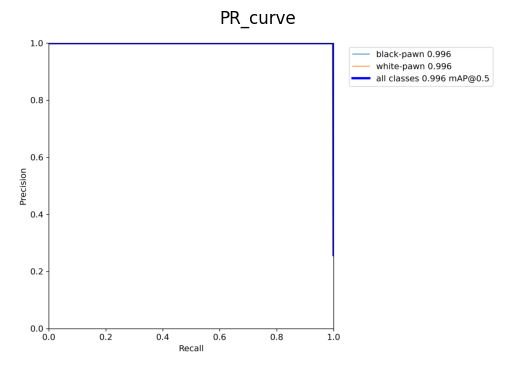

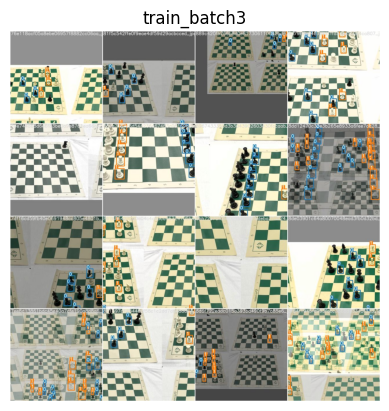

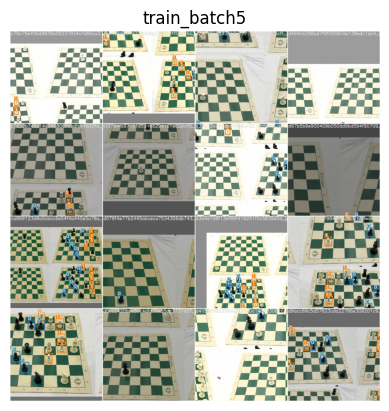

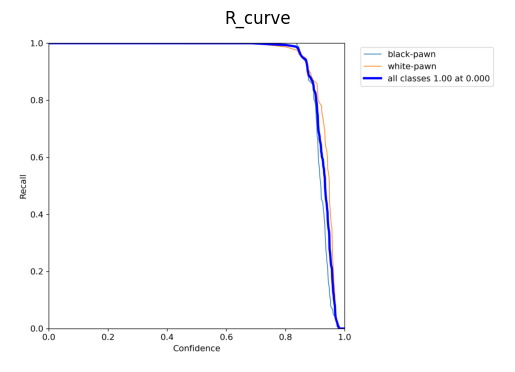

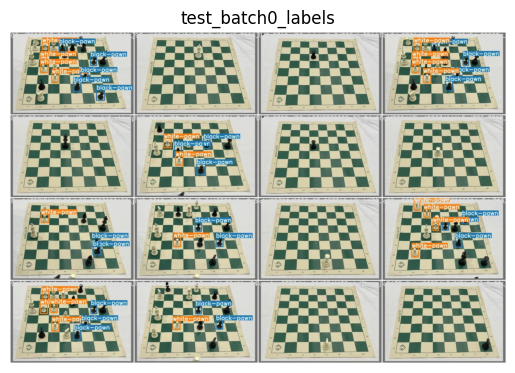

...

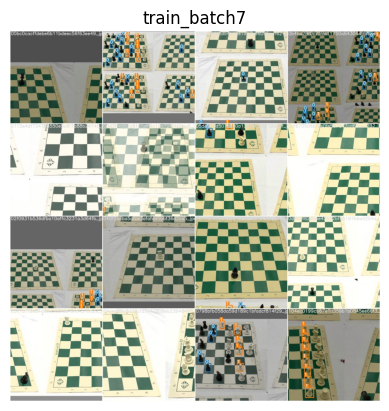

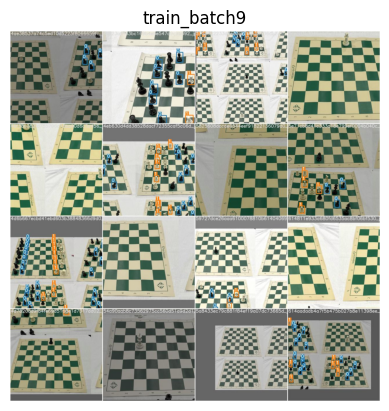

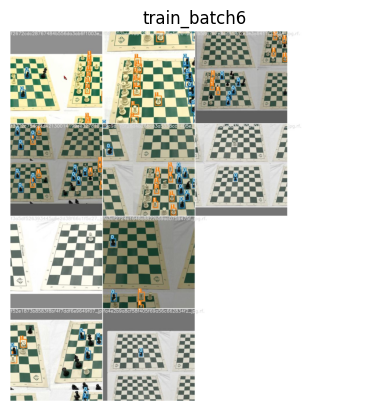

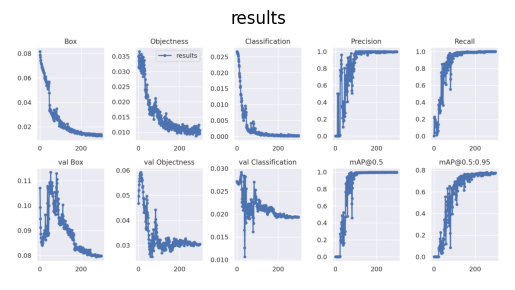

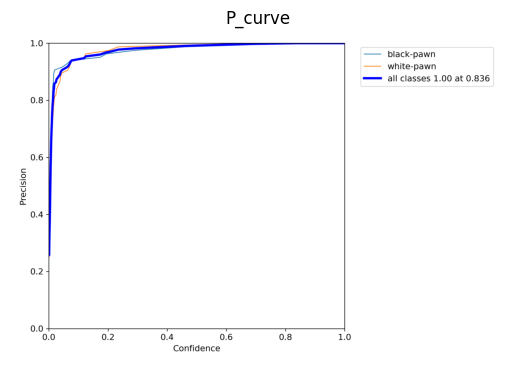

In [23]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Specify the directory path where your images are located
image_dir = '/content/yolov7/runs/train/yolov74'  # Update with the actual path to your image folder

# List all files in the directory
image_files = os.listdir(image_dir)

# Iterate through the files and display each image with a title
for filename in image_files:
    if filename.endswith(('.jpg', '.jpeg', '.png')):  # Add more extensions if needed
        # Construct the full path to the image
        image_path = os.path.join(image_dir, filename)

        # Load and display the image
        img = mpimg.imread(image_path)

        # Extract the image file name (without extension) as the title
        title = os.path.splitext(filename)[0]

        # Create a subplot with a title
        plt.figure()
        plt.imshow(img)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off axis labels and ticks
        plt.show()


## Test val images

check weights and source paths

In [26]:
!python detect.py --weights /content/yolov7/runs/train/yolov74/weights/last.pt --conf 0.25 --img-size 320 --source /content/yolov7/data/images/valid

Namespace(weights=['/content/yolov7/runs/train/yolov74/weights/last.pt'], source='/content/yolov7/data/images/valid', img_size=320, conf_thres=0.25, iou_thres=0.45, device='', view_img=False, save_txt=False, save_conf=False, nosave=False, classes=None, agnostic_nms=False, augment=False, update=False, project='runs/detect', name='exp', exist_ok=False, no_trace=False)
YOLOR 🚀 v0.1-126-g84932d7 torch 2.0.1+cu118 CUDA:0 (Tesla T4, 15101.8125MB)

Fusing layers... 
IDetect.fuse
Model Summary: 208 layers, 6010302 parameters, 0 gradients
 Convert model to Traced-model... 
 traced_script_module saved! 
 model is traced! 

/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
5 black-pawns, 5 white-pawns, Done. (3.6ms) Inference, (1.4ms) NMS


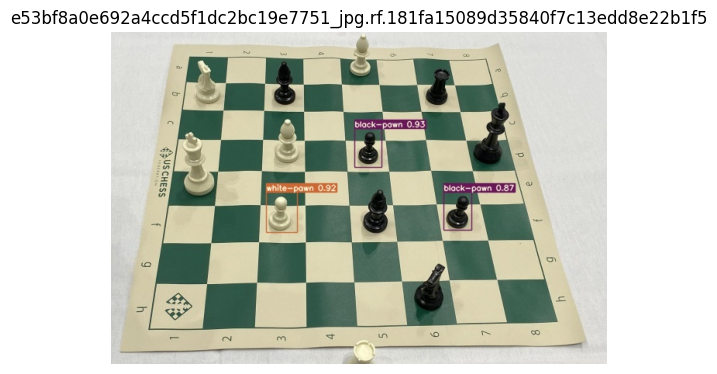

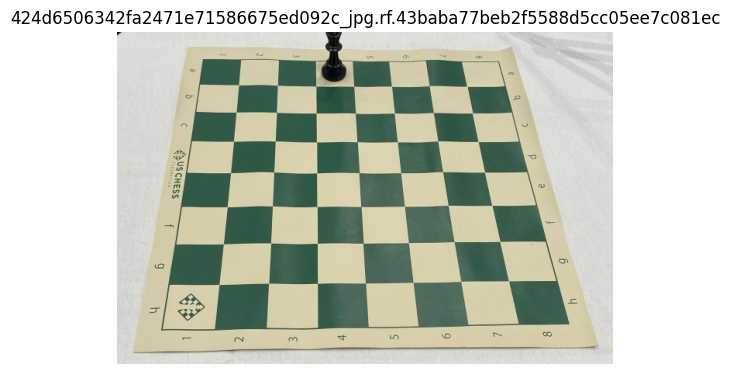

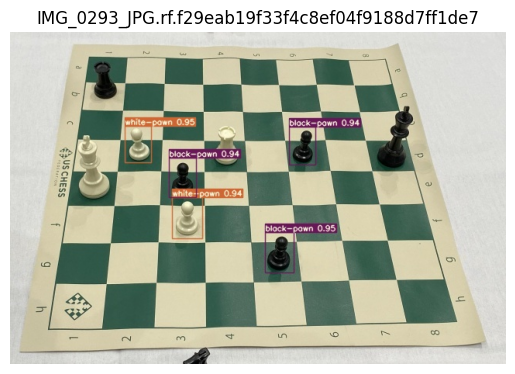

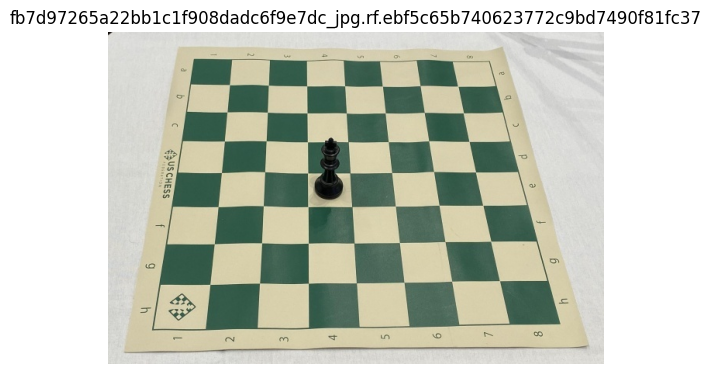

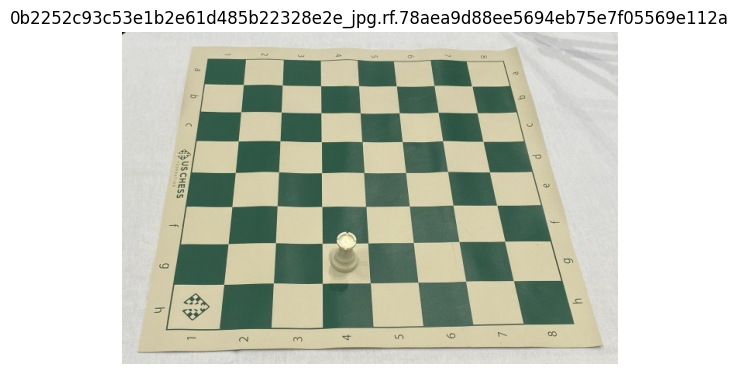

...

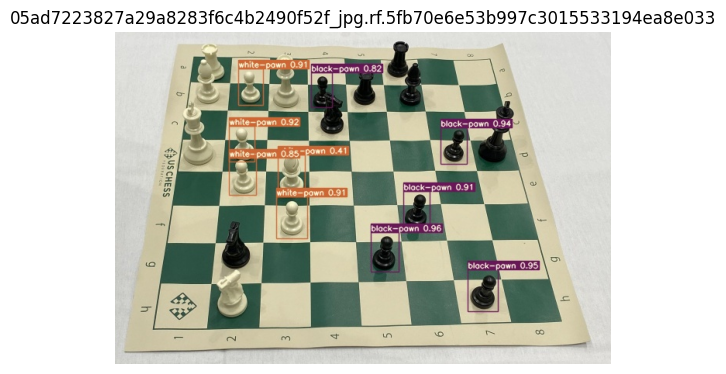

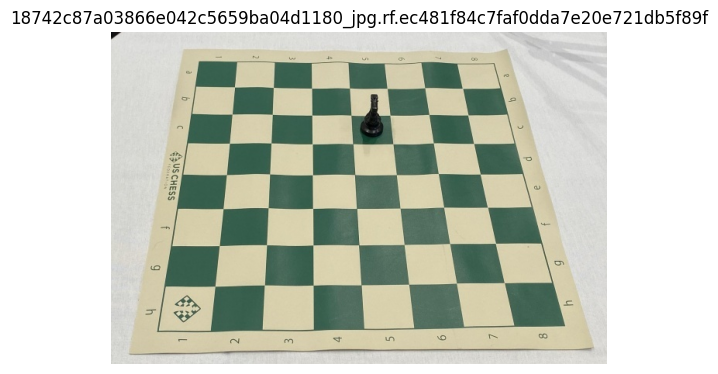

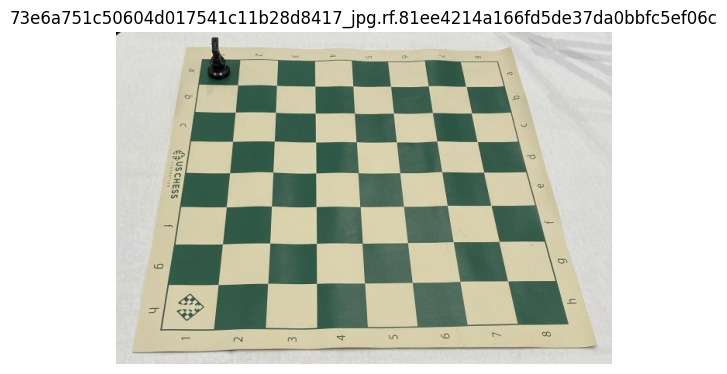

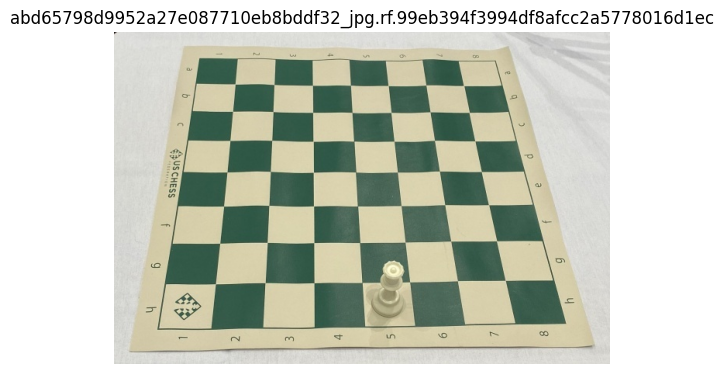

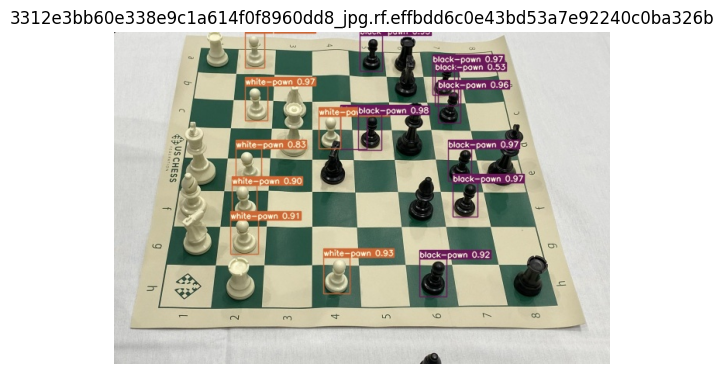

In [28]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Specify the directory path where your images are located
image_dir = '/content/yolov7/runs/detect/exp2'  # Update with the actual path to your image folder

# List all files in the directory
image_files = os.listdir(image_dir)

# Iterate through the files and display each image with a title
for filename in image_files:
    if filename.endswith(('.jpg', '.jpeg', '.png')):  # Add more extensions if needed
        # Construct the full path to the image
        image_path = os.path.join(image_dir, filename)

        # Load and display the image
        img = mpimg.imread(image_path)

        # Extract the image file name (without extension) as the title
        title = os.path.splitext(filename)[0]

        # Create a subplot with a title
        plt.figure()
        plt.imshow(img)
        plt.title(title)
        plt.axis('off')  # Optional: Turn off axis labels and ticks
        plt.show()

## Download records

Be sure there is only one folder in runs/train and runs/detect. Otherwise you'll download all records including your previous trainings and tests

In [ ]:
!zip -r /content/detect_single_class.zip /content/yolov7/runs/

  adding: content/yolov7/runs/ (stored 0%)
  adding: content/yolov7/runs/detect/ (stored 0%)
  adding: content/yolov7/runs/detect/exp/ (stored 0%)
  adding: content/yolov7/runs/detect/exp/c8d3d5c4-01ae-4d5b-a38e-65340cb91ed6.jpg (deflated 0%)
  adding: content/yolov7/runs/detect/exp/a78c996a-1aa7-4300-89a9-d9f5e4d0c796.jpg (deflated 0%)
  adding: content/yolov7/runs/detect/exp/ec22e7bc-b996-450b-93b7-4fe475cfbe0b.jpg (deflated 0%)
  adding: content/yolov7/runs/train/ (stored 0%)
  adding: content/yolov7/runs/train/yolov7/ (stored 0%)
  adding: content/yolov7/runs/train/yolov7/opt.yaml (deflated 48%)
  adding: content/yolov7/runs/train/yolov7/R_curve.png (deflated 34%)
  adding: content/yolov7/runs/train/yolov7/train_batch2.jpg (deflated 2%)
  adding: content/yolov7/runs/train/yolov7/train_batch5.jpg (deflated 1%)
  adding: content/yolov7/runs/train/yolov7/hyp.yaml (deflated 45%)
  adding: content/yolov7/runs/train/yolov7/train_batch1.jpg (deflated 2%)
  adding: content/yolov7/runs/trai

In [ ]:
from google.colab import files
files.download("/content/detect_single_class.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>